# Audit and Loading Functions

In [ ]:
import json
import numpy as np
import pandas as pd
from pathlib import Path
from scipy import interpolate
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots

class BatteryISUDatasetBuilder:
    def __init__(self, path, interpolation_points=1000, rated_capacity=0.25,
                 interpolation_targets={'q': True, 'i': True, 'e': True},
                 mode='spline'):
        self.path = path
        self.interpolation_points = interpolation_points
        self.rated_capacity = rated_capacity
        self.interpolation_targets = interpolation_targets
        self.v_grid = np.linspace(3.0, 4.18, interpolation_points)
        self.batch2 = {
            'G57C1','G57C2','G57C3','G57C4','G58C1',
            'G26C3','G49C1','G49C2','G49C3','G49C4',
            'G50C1','G50C3','G50C4'
        }
        self.Temp = 30  # Default temperature
        self.mode = mode

########### check and audit functions

    def plot_rpt_signal_lengths(self, data, cell_id="", skip_indices=None, print_summary=True):
        if skip_indices is None:
            skip_indices = []

        lengths = []
        for i in range(len(data['QV_discharge_C_5']['Q'])):
            if i in skip_indices:
                continue
            q_len = len(data['QV_discharge_C_5']['Q'][i])
            v_len = len(data['QV_discharge_C_5']['V'][i])
            i_len = len(data['QV_discharge_C_5']['I'][i])
            e_len = len(data['QV_discharge_C_5']['E'][i])
            t_len = len(data['QV_discharge_C_5']['t'][i])
            lengths.append((i, q_len, v_len, i_len, e_len, t_len))
            print(f"RPT {i}: lengths = [Q={q_len}, V={v_len}, I={i_len}, E={e_len}, T={t_len}]")

        if not lengths:
            print("No valid RPTs to display.")
            return

        rpt_indices = [x[0] for x in lengths]
        q_lens = [x[1] for x in lengths]
        v_lens = [x[2] for x in lengths]
        i_lens = [x[3] for x in lengths]
        e_lens = [x[4] for x in lengths]
        t_lens = [x[5] for x in lengths]

        if print_summary:
            print(f"Included RPTs: {len(rpt_indices)}")
            print(f"Min: {min(q_lens)}, Max: {max(q_lens)}, Mean: {np.mean(q_lens):.1f}")

        plt.figure(figsize=(10, 6))
        plt.plot(rpt_indices, q_lens, label='Q length')
        plt.plot(rpt_indices, v_lens, label='V length')
        plt.plot(rpt_indices, i_lens, label='I length')
        plt.plot(rpt_indices, e_lens, label='E length')
        plt.plot(rpt_indices, t_lens, label='T length', linestyle='--', alpha=0.7)

        plt.xlabel("RPT Cycle Index")
        plt.ylabel("Signal Length")
        plt.title(f"Signal Lengths per RPT — {cell_id}")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    def diagnose_signal_alignment_issues(self, data, cell_id=""):
        """Diagnose signal misalignments, length mismatches, and missing entries with detailed reasons."""
        q_cycles = data["QV_discharge_C_5"].get("Q", [])
        v_cycles = data["QV_discharge_C_5"].get("V", [])
        i_cycles = data["QV_discharge_C_5"].get("I", [])
        e_cycles = data["QV_discharge_C_5"].get("E", [])
        t_cycles = data["QV_discharge_C_5"].get("t", [])

        max_len = max(len(q_cycles), len(v_cycles), len(i_cycles), len(e_cycles), len(t_cycles))
        mismatch_log = []
        issue_log = []

        for idx in range(max_len):
            # Get lengths (use -1 for out-of-range)
            lengths = {
                "Q": len(q_cycles[idx]) if idx < len(q_cycles) and isinstance(q_cycles[idx], list) else -1,
                "V": len(v_cycles[idx]) if idx < len(v_cycles) and isinstance(v_cycles[idx], list) else -1,
                "I": len(i_cycles[idx]) if idx < len(i_cycles) and isinstance(i_cycles[idx], list) else -1,
                "E": len(e_cycles[idx]) if idx < len(e_cycles) and isinstance(e_cycles[idx], list) else -1,
                "T": len(t_cycles[idx]) if idx < len(t_cycles) and isinstance(t_cycles[idx], list) else -1
            }

            # Detect length mismatch across signals
            length_values = [v for v in lengths.values() if v >= 0]
            if len(set(length_values)) > 1:
                mismatch_log.append((cell_id, idx, lengths))

            # Detect missing, empty, or invalid signals
            for signal_name, signal_list in zip(
                ["Q", "V", "I", "E", "T"],
                [q_cycles, v_cycles, i_cycles, e_cycles, t_cycles]
            ):
                reason = None
                if idx >= len(signal_list):
                    reason = "missing (index out of range)"
                elif not isinstance(signal_list[idx], list):
                    reason = f"invalid type: {type(signal_list[idx]).__name__}"
                elif len(signal_list[idx]) == 0:
                    reason = "present but empty list"

                if reason:
                    issue_log.append((cell_id, idx, signal_name, reason))

        print(f"\nAlignment diagnostics for {cell_id}")
        print(f"Mismatched lengths: {len(mismatch_log)}")
        print(f"Problematic signals: {len(issue_log)}\n")

        for m in mismatch_log:
            print(f"RPT {m[1]}: length mismatch → {m[2]}")
        for cell, idx, signal, reason in issue_log:
            print(f"RPT {idx}: signal '{signal}' : {reason}")

        return mismatch_log, issue_log

    def describe_duplicates(self, df, cell_id, cycle_index, signal='voltage_raw'):
        """
        Count duplicate timestamps and how often their corresponding signal values vary.
        """
        import pandas as pd
        row = df[(df["cell_id"] == cell_id) & (df["cycle_index"] == cycle_index)]
        if row.empty:
            print("❌ Entry not found.")
            return

        T = np.array(row["time_raw"].values[0])
        Y = np.array(row[signal].values[0])

        df_check = pd.DataFrame({"T": T, "Y": Y})
        dup_counts = df_check.groupby("T").size()
        dup_values = df_check.groupby("T")["Y"].nunique()

        num_duplicates = (dup_counts > 1).sum()
        num_varying = (dup_values > 1).sum()

        print(f"🔍 Duplicate timestamps: {num_duplicates}")
        print(f"📉 Duplicates with varying values: {num_varying}")
        return num_duplicates, num_varying

    def compare_derivatives(self, df, cell_id, cycle_index, signal='voltage_raw'):
        """
        Compare dY/dt statistics between 'remove duplicates' and 'average duplicates' strategies.
        """
        import numpy as np
        import pandas as pd

        row = df[(df["cell_id"] == cell_id) & (df["cycle_index"] == cycle_index)]
        if row.empty:
            print("❌ Entry not found.")
            return

        T = np.array(row["time_raw"].values[0])
        Y = np.array(row[signal].values[0])

        if len(T) != len(Y):
            print(f"❌ Mismatch: len(T)={len(T)} vs len({signal})={len(Y)}")
            return

        # Remove duplicates
        mask = np.diff(T, prepend=-np.inf) > 0
        T_clean, Y_clean = T[mask], Y[mask]

        # Average duplicates
        df_avg = pd.DataFrame({'T': T, 'Y': Y}).groupby('T', as_index=False).mean()
        T_avg, Y_avg = df_avg['T'].values, df_avg['Y'].values

        # Compute derivatives
        d_clean = np.gradient(Y_clean, T_clean)
        d_avg = np.gradient(Y_avg, T_avg)

        # Stats function
        def stats(g): return np.round([g.min(), g.max(), g.mean(), g.std()], 6)

        print("📊 dY/dt stats (Removed duplicates):", stats(d_clean))
        print("📊 dY/dt stats (Averaged duplicates):", stats(d_avg))

        # Difference
        min_len = min(len(d_clean), len(d_avg))
        diff = np.abs(d_clean[:min_len] - d_avg[:min_len])
        print("🔎 Mean absolute diff in dY/dt:", np.mean(diff))

        return d_clean, d_avg

    def audit_duplicate_removal_safety(self, df, signal="voltage_raw", threshold=1e-5):
        """
        Audit each cycle to determine whether removing duplicates significantly affects dY/dt.
        Returns a DataFrame with the 'safe_to_remove' flag per cycle.
        """
        import numpy as np
        import pandas as pd

        results = []

        for _, row in df.iterrows():
            cell_id = row["cell_id"]
            cycle_index = row["cycle_index"]
            T = np.array(row["time_raw"])
            Y = np.array(row[signal])

            # Skip mismatched or malformed rows
            if len(T) != len(Y) or len(T) < 3:
                results.append((cell_id, cycle_index, np.nan, np.nan, np.nan, False))
                continue

            # Remove duplicates
            mask = np.diff(T, prepend=-np.inf) > 0
            T_clean, Y_clean = T[mask], Y[mask]

            # Average duplicates
            df_avg = pd.DataFrame({'T': T, 'Y': Y}).groupby('T', as_index=False).mean()
            T_avg, Y_avg = df_avg['T'].values, df_avg['Y'].values

            # Compute derivatives
            try:
                d_clean = np.gradient(Y_clean, T_clean)
                d_avg = np.gradient(Y_avg, T_avg)

                min_len = min(len(d_clean), len(d_avg))
                diff = np.abs(d_clean[:min_len] - d_avg[:min_len])
                mean_abs_diff = np.mean(diff)

                # Flag: is removing duplicates safe?
                is_safe = mean_abs_diff < threshold

                results.append((cell_id, cycle_index, mean_abs_diff, d_clean.std(), d_avg.std(), is_safe))

            except Exception:
                results.append((cell_id, cycle_index, np.nan, np.nan, np.nan, False))

        return pd.DataFrame(results, columns=[
            "cell_id", "cycle_index", "mean_abs_dYdt_diff", "std_dYdt_clean", "std_dYdt_avg", "safe_to_remove"
        ])

########### data processing functions

    def load_json_files(self, cell_id):
        subfolder = 'Release 2.0' if cell_id in self.batch2 else 'Release 1.0'
        path = Path(f'{self.path}/RPT_json/{subfolder}/{cell_id}.json')
        with path.open('r') as file:
            data = json.loads(json.load(file))

        start = data['start_stop_time']['start']
        stop = data['start_stop_time']['stop']
        for i, s in enumerate(start):
            data['start_stop_time']['start'][i] = np.datetime64(s) if s != '[]' else []
            data['start_stop_time']['stop'][i] = np.datetime64(stop[i]) if s != '[]' else []

        for i, t_list in enumerate(data['QV_discharge_C_5']['t']):
            if len(t_list) > 0:
                data['QV_discharge_C_5']['t'][i] = list(map(np.datetime64, t_list))

        return data

    def validate_all_against_voltage_time(self, t_v, **kwargs):
        all_good = True
        t_v = np.array(t_v, dtype='datetime64[s]')
        for name, t_arr in kwargs.items():
            t_arr = np.array(t_arr, dtype='datetime64[s]')
            if len(t_arr) != len(t_v):
                print(f"[Mismatch] {name}: len={len(t_arr)} vs voltage len={len(t_v)}")
                all_good = False
                continue
            diff_sec = np.abs((t_arr - t_v).astype('timedelta64[s]').astype(float))
            if np.any(diff_sec > 1):
                print(f"[Mismatch] {name}: max time diff = {np.max(diff_sec)}s")
                all_good = False
        return all_good

    def compute_derivative_stats(self, Y, T):
        T = np.array(T, dtype=float)
        if len(Y) != len(T) or len(Y) < 2:
            return {"min": np.nan, "max": np.nan, "mean": np.nan, "std": np.nan}

        # Remove duplicates in T
        valid = np.diff(T, prepend=-np.inf) > 0
        T, Y = T[valid], np.array(Y)[valid]

        if len(T) < 2:
            return {"min": np.nan, "max": np.nan, "mean": np.nan, "std": np.nan}

        dYdt = np.gradient(Y, T)
        return {
            "min": np.min(dYdt),
            "max": np.max(dYdt),
            "mean": np.mean(dYdt),
            "std": np.std(dYdt)
        }

    def sample_signal(self, V, Y):
        V, Y = np.array(V), np.array(Y)
        mask = (V >= 3.0) & (V <= 4.18)
        V, Y = V[mask], Y[mask]
        if len(V) < 2:
            return None
        order = np.argsort(V)
        return np.interp(self.v_grid, V[order], Y[order])

    def interpolate_signals(self, V, Q, I, E):
        V, Q, I, E = map(np.array, (V, Q, I, E)) 
        I = -I #override polarity of I here
        mask = (V >= 3.0) & (V <= 4.18)
        if np.count_nonzero(mask) < 10:
            return None

        V, Q, I, E = [x[mask][np.argsort(V[mask])] for x in (V, Q, I, E)]

        if self.mode == 'sample':
            result = {}
            if self.interpolation_targets.get('q'): result['q'] = self.sample_signal(V, Q)
            if self.interpolation_targets.get('i'): result['i'] = self.sample_signal(V, I)
            if self.interpolation_targets.get('e'): result['e'] = self.sample_signal(V, E)
        elif self.mode == 'spline':
            def safe_spline(x, y, s=1e-4):
                if np.allclose(y, y[0], rtol=1e-4):
                    return np.full_like(self.v_grid, y[0])
                for _ in range(5):
                    tck = interpolate.splrep(x, y, s=s)
                    if not np.isnan(tck[1]).any():
                        return interpolate.splev(self.v_grid, tck)
                    s *= 10
                return np.full_like(self.v_grid, np.nan)

            result = {}
            if self.interpolation_targets.get('q'): result['q'] = safe_spline(V, Q)
            if self.interpolation_targets.get('i'): result['i'] = safe_spline(V, I)
            if self.interpolation_targets.get('e'): result['e'] = safe_spline(V, E)
        else:
            raise ValueError("Unknown interpolation mode. Use 'spline' or 'sample'.")

        return result

    def process_single_cell(self, cell_id):
        data = self.load_json_files(cell_id)
        capacities = data['capacity_discharge_C_5']
        result_rows = []

        for i, cap in enumerate(capacities):
            if isinstance(cap, list): continue
            soh = cap / self.rated_capacity
            try:
                signals = {k: data['QV_discharge_C_5'][k][i] for k in ['V', 'Q', 'I', 'E', 't']}

                if not self.validate_all_against_voltage_time(
                    t_v=signals['t'],
                    t_V=signals['t'],
                    t_Q=signals['t'],
                    t_I=signals['t'],
                    t_E=signals['t']
                ):
                    print(f"Skipping {cell_id} RPT {i}: time misalignment")
                    continue
                
                t_raw = np.array(signals['t'], dtype='datetime64[ns]')
                t_seconds = (t_raw - t_raw[0]).astype('timedelta64[ms]').astype(float) / 1000  # milliseconds → seconds
                if np.max(t_seconds) - np.min(t_seconds) < 0.5:
                    print(f"Skipping {cell_id} RPT {i}: time span too small ({np.max(t_seconds):.3f}s)")
                    continue



                interp = self.interpolate_signals(signals['V'], signals['Q'], signals['I'], signals['E'])
                if interp is None: continue

                dqdt = self.compute_derivative_stats(signals["Q"], t_seconds)
                dvdt = self.compute_derivative_stats(signals["V"], t_seconds)
                didt = self.compute_derivative_stats(signals["I"], t_seconds)



                row = {
                    'cell_id': cell_id,
                    "rated_capacity": self.rated_capacity,
                    'cycle_index': i,
                    'capacity': cap,
                    'soh': soh,
                    'voltage_raw': signals['V'],
                    'current_raw': [-i for i in signals['I']],  # Flip I here
                    'charge_raw': signals['Q'],
                    "temperature_raw": self.Temp,
                    'time_raw': t_seconds.tolist(),
            
                    'energy_raw': signals['E'],
                    
                    "dqdt_min": dqdt["min"], "dqdt_max": dqdt["max"],
                    "dqdt_mean": dqdt["mean"], "dqdt_std": dqdt["std"],
                    "dvdt_min": dvdt["min"], "dvdt_max": dvdt["max"],
                    "dvdt_mean": dvdt["mean"], "dvdt_std": dvdt["std"],
                    "didt_min": didt["min"], "didt_max": didt["max"],
                    "didt_mean": didt["mean"], "didt_std": didt["std"]
                }
                for k, v in interp.items():
                    row.update({f'{k}_interp_{j}': val for j, val in enumerate(v)})
                result_rows.append(row)
            except Exception as e:
                print(f"Warning: Skipping RPT {i} for {cell_id}: {e}")
        print(f"Finished processing cell {cell_id}. Rows collected: {len(result_rows)}")
        return pd.DataFrame(result_rows)

    def process_all(self, valid_cells_path='valid_cells.csv'):
        valid_cells = pd.read_csv(valid_cells_path).values.flatten().tolist()
        all_dfs = [self.process_single_cell(cell) for cell in valid_cells]
        final_df = pd.concat([df for df in all_dfs if not df.empty], ignore_index=True)
        print(f"Done. Total entries: {len(final_df)}")
        return final_df

    def plot_qie_from_dataframe(self, df, cell_id, cycle_index):
        row = df[(df['cell_id'] == cell_id) & (df['cycle_index'] == cycle_index)]
        if row.empty:
            print("Entry not found.")
            return

        q_vals = row.filter(like='q_interp_').values.flatten()
        i_vals = row.filter(like='i_interp_').values.flatten()
        e_vals = row.filter(like='e_interp_').values.flatten()

        V_raw = np.array(row['voltage_raw'].values[0])
        Q_raw = np.array(row['charge_raw'].values[0])
        I_raw = np.array(row['current_raw'].values[0])
        E_raw = np.array(row['energy_raw'].values[0])

        idx = (V_raw >= 3.0) & (V_raw <= 4.2)
        V_raw, Q_raw, E_raw, I_raw = V_raw[idx], Q_raw[idx], E_raw[idx], I_raw[idx]

        order = np.argsort(V_raw)
        V_raw, Q_raw, E_raw, I_raw = V_raw[order], Q_raw[order], E_raw[order], I_raw[order]

        fig, axs = plt.subplots(1, 3, figsize=(18, 5))

        axs[0].plot(V_raw, Q_raw, label="Raw Q", linestyle='-')
        axs[0].plot(self.v_grid, q_vals, label="Interpolated Q", linestyle='--')
        axs[0].set_title("Q vs V")
        axs[0].set_ylabel("Charge (Ah)")
        axs[0].legend()
        axs[0].grid(True)

        axs[1].plot(V_raw, I_raw, label="Raw I", linestyle='-')
        axs[1].plot(self.v_grid, i_vals, label="Interpolated I", linestyle='--')
        axs[1].set_title("I vs V")
        axs[1].set_ylabel("Current (A)")
        axs[1].legend()
        axs[1].grid(True)

        axs[2].plot(V_raw, E_raw, label="Raw E", linestyle='-')
        axs[2].plot(self.v_grid, e_vals, label="Interpolated E", linestyle='--')
        axs[2].set_title("E vs V")
        axs[2].set_ylabel("Energy (Wh)")
        axs[2].legend()
        axs[2].grid(True)

        for ax in axs:
            ax.set_xlabel("Voltage (V)")

        fig.suptitle(f"Interpolation Plots for {cell_id} — Cycle Index {cycle_index}")
        plt.tight_layout()
        plt.show()

    def plot_multiple_cycles(self, df, cell_id, cycle_idx, signal='q'):
        plt.figure(figsize=(8, 5))
        for idx in cycle_idx:
            row = df[(df['cell_id'] == cell_id) & (df['cycle_index'] == idx)]
            if row.empty:
                print(f"Row not found for {cell_id} RPT {idx}")
                continue
            y_vals = row[[f'{signal}_interp_{i}' for i in range(self.interpolation_points)]].values.flatten()
            plt.plot(self.v_grid, y_vals, label=f'RPT {idx}')

        plt.title(f'{signal.upper()} vs Voltage for {cell_id}')
        plt.xlabel('Voltage (V)')
        plt.ylabel(signal.upper())
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    def plot_signals_and_derivatives_vs_time(self, df, cell_id, cycle_index):
        row = df[(df["cell_id"] == cell_id) & (df["cycle_index"] == cycle_index)]
        if row.empty:
            print("Entry not found.")
            return

        T = np.array(row["time_raw"].values[0])
        Q = np.array(row["charge_raw"].values[0])
        V = np.array(row["voltage_raw"].values[0])
        I = np.array(row["current_raw"].values[0])

        # Sort by time
        order = np.argsort(T)
        T, Q, V, I = T[order], Q[order], V[order], I[order]

        dQdt = np.gradient(Q, T)
        dVdt = np.gradient(V, T)
        dIdt = np.gradient(I, T)

        fig, axs = plt.subplots(3, 2, figsize=(14, 9), sharex=True)

        # Left column: raw signals
        axs[0, 0].plot(T, Q, label="Q (Ah)")
        axs[0, 0].set_ylabel("Charge (Ah)")
        axs[0, 0].legend()
        axs[0, 0].grid(True)

        axs[1, 0].plot(T, V, label="V (V)", color="orange")
        axs[1, 0].set_ylabel("Voltage (V)")
        axs[1, 0].legend()
        axs[1, 0].grid(True)

        axs[2, 0].plot(T, I, label="I (A)", color="green")
        axs[2, 0].set_ylabel("Current (A)")
        axs[2, 0].legend()
        axs[2, 0].grid(True)

        # Right column: derivatives
        axs[0, 1].plot(T, dQdt, label="dQ/dt", color="blue")
        axs[0, 1].set_ylabel("dQ/dt (A)")
        axs[0, 1].legend()
        axs[0, 1].grid(True)

        axs[1, 1].plot(T, dVdt, label="dV/dt", color="orange")
        axs[1, 1].set_ylabel("dV/dt (V/s)")
        axs[1, 1].legend()
        axs[1, 1].grid(True)

        axs[2, 1].plot(T, dIdt, label="dI/dt", color="green")
        axs[2, 1].set_ylabel("dI/dt (A/s)")
        axs[2, 1].legend()
        axs[2, 1].grid(True)

    def plot_signals_and_derivatives_plotly(self, df, cell_id, cycle_index):
        row = df[(df["cell_id"] == cell_id) & (df["cycle_index"] == cycle_index)]
        if row.empty:
            print("Entry not found.")
            return

        T = np.array(row["time_raw"].values[0])
        if np.issubdtype(T.dtype, np.datetime64):
            T = (T - T[0]).astype('timedelta64[s]').astype(float)
        Q = np.array(row["charge_raw"].values[0])
        V = np.array(row["voltage_raw"].values[0])
        I = np.array(row["current_raw"].values[0])

        order = np.argsort(T)
        T, Q, V, I = T[order], Q[order], V[order], I[order]

        dQdt = np.gradient(Q, T)
        dVdt = np.gradient(V, T)
        dIdt = np.gradient(I, T)

        fig = make_subplots(rows=3, cols=2, shared_xaxes=True,
                            subplot_titles=("Q (Ah)", "dQ/dt (A)",
                                            "V (V)", "dV/dt (V/s)",
                                            "I (A)", "dI/dt (A/s)"))

        fig.add_trace(go.Scatter(x=T, y=Q, mode='lines', name='Q (Ah)'), row=1, col=1)
        fig.add_trace(go.Scatter(x=T, y=dQdt, mode='lines', name='dQ/dt (A)', line=dict(color='blue')), row=1, col=2)

        fig.add_trace(go.Scatter(x=T, y=V, mode='lines', name='V (V)', line=dict(color='orange')), row=2, col=1)
        fig.add_trace(go.Scatter(x=T, y=dVdt, mode='lines', name='dV/dt (V/s)', line=dict(color='orange')), row=2, col=2)

        fig.add_trace(go.Scatter(x=T, y=I, mode='lines', name='I (A)', line=dict(color='green')), row=3, col=1)
        fig.add_trace(go.Scatter(x=T, y=dIdt, mode='lines', name='dI/dt (A/s)', line=dict(color='green')), row=3, col=2)

        fig.update_layout(height=900, width=1150,
                        title_text=f"Interactive Signal and Derivative Plots for {cell_id} — Cycle {cycle_index}",
                        showlegend=False)

        
        fig.update_xaxes(title_text="Time (s)", dtick=500, row=1, col=1)
        fig.update_xaxes(title_text="Time (s)", dtick=500, row=1, col=2)
        fig.update_xaxes(title_text="Time (s)", dtick=500, row=2, col=1)
        fig.update_xaxes(title_text="Time (s)", dtick=500, row=2, col=2)
        fig.update_xaxes(title_text="Time (s)", dtick=500, row=3, col=1)
        fig.update_xaxes(title_text="Time (s)", dtick=500, row=3, col=2)

        fig.show()

# Run for single cell - sample

In [2]:
# run for single cell only
sample_builder = BatteryISUDatasetBuilder(
    path="../Datasets",
    interpolation_points=500,
    interpolation_targets={'q': True, 'i': True, 'e': True},
    mode='spline'  # interpolation method, use 'sample' or 'spline'
)

In [3]:
df_isu_sample = sample_builder.process_single_cell("G20C2")
df_isu_sample.head()

c:\Users\adien\anaconda3\Lib\site-packages\scipy\interpolate\_fitpack_py.py:304: RuntimeWarning: The maximal number of iterations (20) allowed for finding smoothing
spline with fp=s has been reached. Probable cause: s too small.
(abs(fp-s)/s>0.001)
  res = _impl.splrep(x, y, w, xb, xe, k, task, s, t, full_output, per, quiet)


Finished processing cell G20C2. Rows collected: 10


,cell_id,rated_capacity,cycle_index,capacity,soh,voltage_raw,current_raw,charge_raw,temperature_raw,time_raw,...,e_interp_490,e_interp_491,e_interp_492,e_interp_493,e_interp_494,e_interp_495,e_interp_496,e_interp_497,e_interp_498,e_interp_499
0,G20C2,0.25,0,0.285404,1.141614,"[4.1858, 4.1812, 4.179, 4.1772, 4.1756, 4.1737...","[0.0500120010375977, 0.0500120010375977, 0.050...","[0.0, 6.94611111111111e-05, 0.0001389225, 0.00...",30,"[0.0, 5.0, 10.0, 15.0, 20.0, 25.0, 30.0, 35.0,...",...,0.006036,0.005133,0.004256,0.003403,0.002576,0.001773,0.000994,0.000239,-0.000492,-0.001199
1,G20C2,0.25,1,0.284554,1.138218,"[4.1883, 4.1827, 4.1806, 4.1787, 4.1775, 4.175...","[0.0500060005187988, 0.0500120010375977, 0.050...","[0.0, 6.94605555555556e-05, 0.0001389216666666...",30,"[0.0, 5.0, 10.0, 15.0, 20.0, 25.0, 30.0, 35.0,...",...,0.007374,0.006321,0.005296,0.004298,0.003327,0.002383,0.001466,0.000574,-0.000293,-0.001134
2,G20C2,0.25,2,0.282294,1.129177,"[4.1877, 4.1827, 4.1824, 4.1799, 4.1781, 4.176...","[0.0500120010375977, 0.0500120010375977, 0.050...","[0.0, 5.55688888888889e-05, 6.94611111111111e-...",30,"[0.0, 4.0, 5.0, 10.0, 15.0, 20.0, 25.0, 30.0, ...",...,0.007181,0.006151,0.005156,0.004197,0.003274,0.002387,0.001535,0.000718,-0.000063,-0.000808
3,G20C2,0.25,3,0.278273,1.113091,"[4.1877, 4.1827, 4.1809, 4.1784, 4.1765, 4.174...","[0.0500120010375977, 0.0500120010375977, 0.050...","[0.0, 3.61197222222222e-05, 6.94611111111111e-...",30,"[0.0, 3.0, 5.0, 10.0, 15.0, 20.0, 25.0, 30.0, ...",...,0.006225,0.005226,0.004266,0.003343,0.002459,0.001613,0.000804,0.000034,-0.000699,-0.001394
4,G20C2,0.25,4,0.273710,1.094841,"[4.1877, 4.1827, 4.1796, 4.1762, 4.1737, 4.171...","[0.0500120010375977, 0.0500120010375977, 0.050...","[0.0, 2.77844444444444e-05, 6.94611111111111e-...",30,"[0.0, 2.0, 5.0, 10.0, 15.0, 20.0, 25.0, 30.0, ...",...,0.004596,0.003794,0.003068,0.002421,0.001854,0.001371,0.000976,0.000671,0.000459,0.000343


## Audit - entries length

RPT 1: lengths = [Q=4033, V=4033, I=4033, E=4033, T=4033]
RPT 2: lengths = [Q=4014, V=4014, I=4014, E=4014, T=4014]
RPT 3: lengths = [Q=3996, V=3996, I=3996, E=3996, T=3996]
RPT 4: lengths = [Q=3990, V=3990, I=3990, E=3990, T=3990]
RPT 5: lengths = [Q=3973, V=3973, I=3973, E=3973, T=3973]
RPT 6: lengths = [Q=3950, V=3950, I=3950, E=3950, T=3950]
RPT 7: lengths = [Q=3929, V=3929, I=3929, E=3929, T=3929]
RPT 8: lengths = [Q=3921, V=3921, I=3921, E=3921, T=3921]
RPT 9: lengths = [Q=3909, V=3909, I=3909, E=3909, T=3909]
RPT 10: lengths = [Q=3885, V=3885, I=3885, E=3885, T=3885]
RPT 11: lengths = [Q=3874, V=3874, I=3874, E=3874, T=3874]
RPT 12: lengths = [Q=3847, V=3847, I=3847, E=3847, T=3847]
RPT 13: lengths = [Q=3822, V=3822, I=3822, E=3822, T=3822]
RPT 14: lengths = [Q=3812, V=3812, I=3812, E=3812, T=3812]
RPT 15: lengths = [Q=3795, V=3795, I=3795, E=3795, T=3795]
RPT 16: lengths = [Q=3778, V=3778, I=3778, E=3778, T=3778]
RPT 17: lengths = [Q=3770, V=3770, I=3770, E=3770, T=3770]
RPT 18

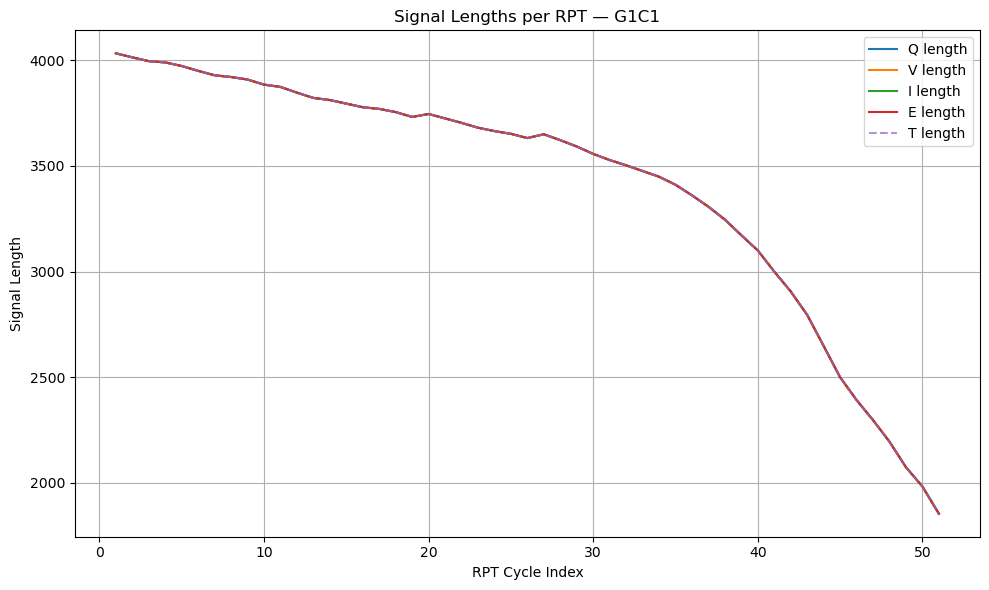

In [5]:
sample_builder.plot_rpt_signal_lengths(sample_builder.load_json_files("G1C1"), skip_indices=[0], cell_id="G1C1")

## Audit - empty list

In [6]:
_ = sample_builder.diagnose_signal_alignment_issues(sample_builder.load_json_files("G20C2"), cell_id="G20C2")


Alignment diagnostics for G20C2
Mismatched lengths: 0
Problematic signals: 5

RPT 5: signal 'Q' : present but empty list
RPT 5: signal 'V' : present but empty list
RPT 5: signal 'I' : present but empty list
RPT 5: signal 'E' : present but empty list
RPT 5: signal 'T' : present but empty list


## Audit - Remove duplicate timestamps

In [110]:
sample_builder.describe_duplicates(df_isu_sample, cell_id="G20C2", cycle_index=0, signal="voltage_raw")
_ = sample_builder.compare_derivatives(df_isu_sample, cell_id="G20C2", cycle_index=0, signal="voltage_raw")

🔍 Duplicate timestamps: 14
📉 Duplicates with varying values: 13
📊 dY/dt stats (Removed duplicates): [-1.333e-03  0.000e+00 -5.800e-05  1.100e-04]
📊 dY/dt stats (Averaged duplicates): [-1.233e-03  0.000e+00 -5.800e-05  1.090e-04]
🔎 Mean absolute diff in dY/dt: 9.306569343069487e-08


In [114]:
audit_sample_df = sample_builder.audit_duplicate_removal_safety(df_isu_sample, signal="voltage_raw")
display(audit_sample_df.head())


,cell_id,cycle_index,mean_abs_dYdt_diff,std_dYdt_clean,std_dYdt_avg,safe_to_remove
0,G20C2,0,9.306569e-08,0.000110,0.000109,True
1,G20C2,1,0.000000e+00,0.000100,0.000100,True
2,G20C2,2,0.000000e+00,0.000096,0.000096,True
3,G20C2,3,2.245509e-08,0.000098,0.000098,True
4,G20C2,4,0.000000e+00,0.000103,0.000103,True


In [9]:
audit_all_df_isu = sample_builder.audit_duplicate_removal_safety(pd.read_pickle("../Datasets/isu_Interp_flat.pkl"), signal="voltage_raw", threshold=1e-5)
audit_all_df_isu['safe_to_remove'].unique()

array([False,  True])

## Sample EDA

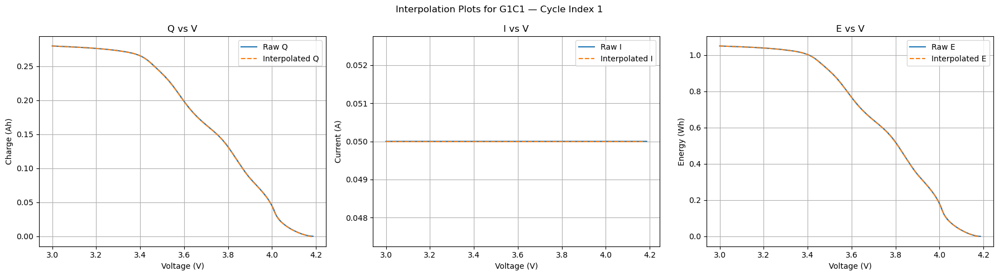

In [5]:
sample_builder.plot_qie_from_dataframe(df_isu_sample, cell_id="G1C1", cycle_index=1)

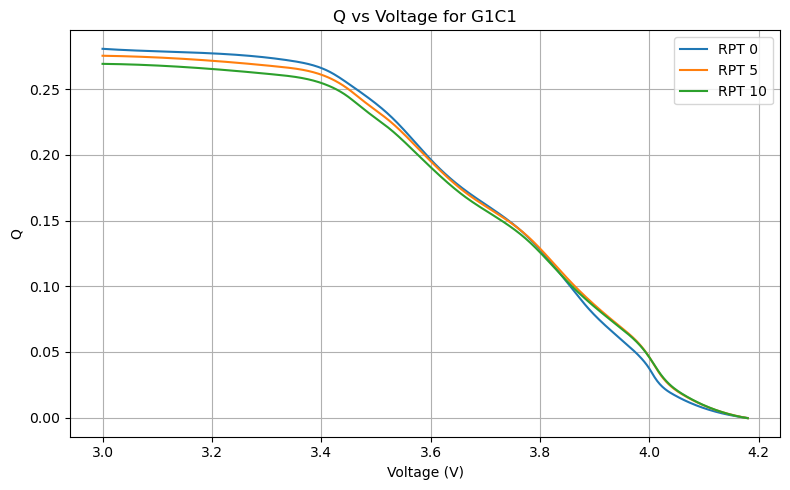

In [6]:
sample_builder.plot_multiple_cycles(df_isu_sample, cell_id="G1C1", cycle_idx=[0, 5, 10], signal='q')

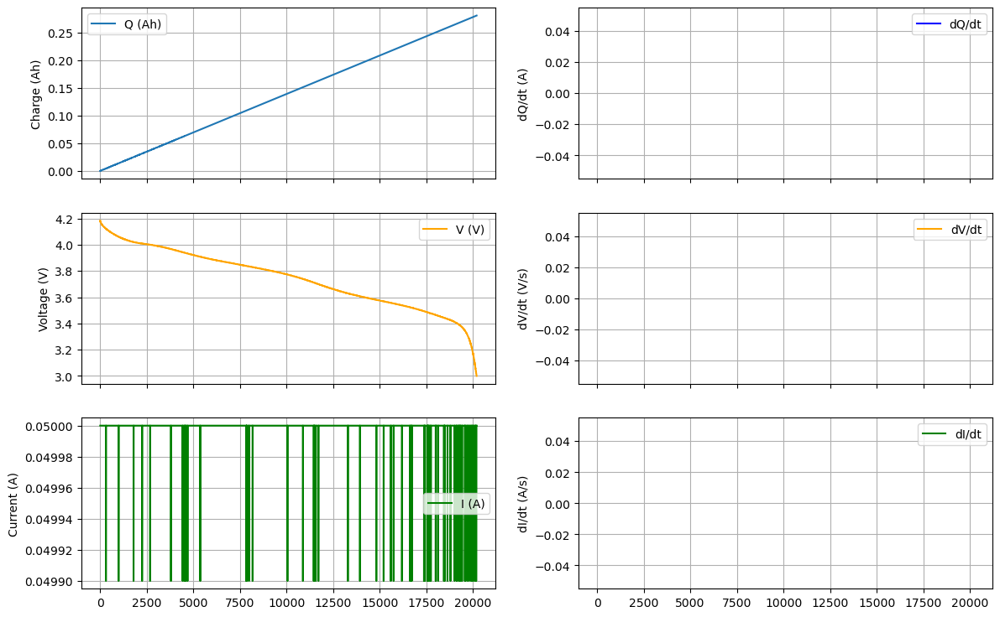

In [31]:
sample_builder.plot_signals_and_derivatives_vs_time(df_isu_sample, cell_id="G1C1", cycle_index=0)


In [23]:
sample_builder.plot_signals_and_derivatives_plotly(df_isu_sample, cell_id="G1C1", cycle_index=0)

c:\Users\adien\anaconda3\Lib\site-packages\numpy\lib\function_base.py:1242: RuntimeWarning:

divide by zero encountered in divide

c:\Users\adien\anaconda3\Lib\site-packages\numpy\lib\function_base.py:1242: RuntimeWarning:

invalid value encountered in divide

c:\Users\adien\anaconda3\Lib\site-packages\numpy\lib\function_base.py:1243: RuntimeWarning:

divide by zero encountered in divide

c:\Users\adien\anaconda3\Lib\site-packages\numpy\lib\function_base.py:1243: RuntimeWarning:

invalid value encountered in divide

c:\Users\adien\anaconda3\Lib\site-packages\numpy\lib\function_base.py:1244: RuntimeWarning:

divide by zero encountered in divide

c:\Users\adien\anaconda3\Lib\site-packages\numpy\lib\function_base.py:1244: RuntimeWarning:

invalid value encountered in divide

c:\Users\adien\anaconda3\Lib\site-packages\numpy\lib\function_base.py:1250: RuntimeWarning:

invalid value encountered in add

c:\Users\adien\anaconda3\Lib\site-packages\numpy\lib\function_base.py:1259: RuntimeWarning

# Run all cells

In [9]:
# run for all cells
builder = BatteryISUDatasetBuilder(
    path= "../Datasets",
    interpolation_points=1000,
    interpolation_targets={'q': True, 'i': True, 'e': True},
    mode='spline'  # interpolation method, use 'sample' or 'spline'
    )

In [10]:
df_isu_all = builder.process_all('valid_cells.csv')

c:\Users\adien\anaconda3\Lib\site-packages\scipy\interpolate\_fitpack_py.py:304: RuntimeWarning:

The maximal number of iterations (20) allowed for finding smoothing
spline with fp=s has been reached. Probable cause: s too small.
(abs(fp-s)/s>0.001)



Finished processing cell G1C1. Rows collected: 52
Finished processing cell G1C2. Rows collected: 62
Finished processing cell G1C3. Rows collected: 68
Finished processing cell G1C4. Rows collected: 31
Finished processing cell G2C1. Rows collected: 26
Finished processing cell G2C2. Rows collected: 29
Finished processing cell G2C3. Rows collected: 28
Finished processing cell G2C4. Rows collected: 28
Finished processing cell G3C1. Rows collected: 31
Finished processing cell G3C2. Rows collected: 19
Finished processing cell G3C3. Rows collected: 28
Finished processing cell G3C4. Rows collected: 19
Finished processing cell G4C1. Rows collected: 26
Finished processing cell G4C2. Rows collected: 27
Finished processing cell G4C3. Rows collected: 30
Finished processing cell G4C4. Rows collected: 21
Finished processing cell G5C1. Rows collected: 14
Finished processing cell G5C2. Rows collected: 16
Finished processing cell G5C3. Rows collected: 16
Finished processing cell G5C4. Rows collected: 10


In [11]:
df_isu_all.head(5)

,cell_id,rated_capacity,cycle_index,capacity,soh,voltage_raw,current_raw,charge_raw,temperature_raw,time_raw,...,e_interp_990,e_interp_991,e_interp_992,e_interp_993,e_interp_994,e_interp_995,e_interp_996,e_interp_997,e_interp_998,e_interp_999
0,G1C1,0.25,0,0.280457,1.121826,"[4.184, 4.184, 4.1837, 4.183, 4.1827, 4.1827, ...","[0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.0...","[0.0, 1.388888888888889e-06, 2.777777777777778...",30,"[0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",...,0.001518,0.001288,0.001067,0.000856,0.000655,0.000464,0.000282,0.000111,-0.000050,-0.000201
1,G1C1,0.25,1,0.279856,1.119422,"[4.1861, 4.1809, 4.1809, 4.1778, 4.1756, 4.173...","[0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.0...","[0.0, 6.388888888888888e-05, 6.944444444444444...",30,"[0.0, 5.0, 5.0, 10.0, 15.0, 20.0, 25.0, 30.0, ...",...,0.001168,0.000777,0.000388,0.000003,-0.000380,-0.000759,-0.001136,-0.001510,-0.001881,-0.002250
2,G1C1,0.25,2,0.278479,1.113917,"[4.1871, 4.1821, 4.1812, 4.1784, 4.1762, 4.174...","[0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.0...","[0.0, 4.722222222222222e-05, 6.944444444444444...",30,"[0.0, 4.0, 5.0, 10.0, 15.0, 20.0, 25.0, 30.0, ...",...,0.001739,0.001386,0.001040,0.000701,0.000368,0.000042,-0.000277,-0.000589,-0.000895,-0.001195
3,G1C1,0.25,3,0.277190,1.108761,"[4.188, 4.183, 4.1815, 4.1787, 4.1765, 4.175, ...","[0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.0...","[0.0, 3.611111111111111e-05, 6.944444444444444...",30,"[0.0, 3.0, 5.0, 10.0, 15.0, 20.0, 25.0, 30.0, ...",...,0.002239,0.001939,0.001650,0.001372,0.001105,0.000848,0.000603,0.000368,0.000145,-0.000067
4,G1C1,0.25,4,0.276860,1.107439,"[4.1877, 4.1827, 4.1815, 4.1787, 4.1765, 4.175...","[0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.0...","[0.0, 4.305555555555555e-05, 6.944444444444444...",30,"[0.0, 3.0, 5.0, 10.0, 15.0, 20.0, 25.0, 30.0, ...",...,0.001882,0.001513,0.001151,0.000797,0.000451,0.000113,-0.000218,-0.000541,-0.000857,-0.001165


In [12]:
# Check object-type columns
df_isu_all.select_dtypes(include='object').columns


Index(['cell_id', 'voltage_raw', 'current_raw', 'charge_raw', 'time_raw',
       'energy_raw'],
      dtype='object')

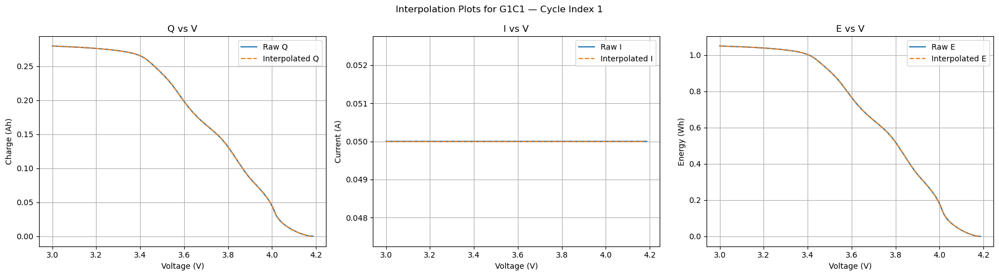

In [13]:
builder.plot_qie_from_dataframe(df_isu_all, cell_id="G1C1", cycle_index=1)

In [30]:
builder.plot_signals_and_derivatives_plotly(df_isu_all, cell_id="G1C3", cycle_index=1)

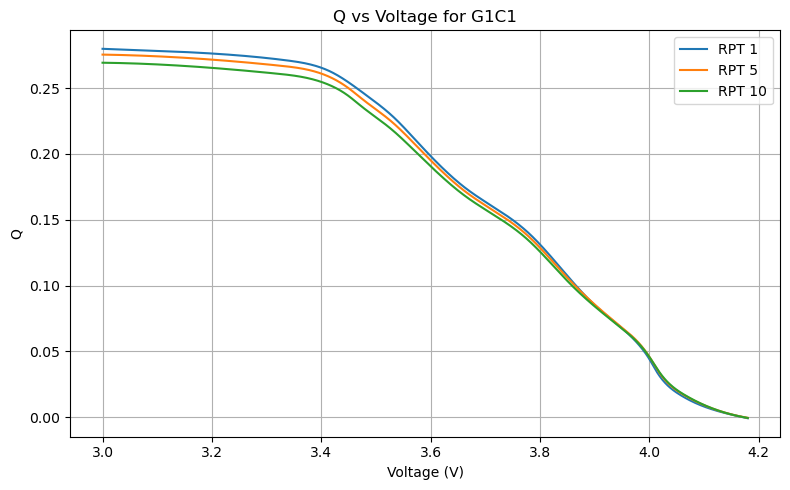

In [14]:
builder.plot_multiple_cycles(df_isu_all, cell_id="G1C1", cycle_idx=[1, 5, 10], signal='q') # 'q' or 'i' or 't'

In [15]:
df_isu_all.to_csv("../Datasets/isu_Interp_flat.csv", index=False)

In [16]:
df_isu_all.to_pickle("../Datasets/isu_Interp_flat.pkl")

In [17]:
df_isu_all_from_pkl = pd.read_pickle("../Datasets/isu_Interp_flat.pkl")

In [18]:
df_isu_all_from_pkl.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5455 entries, 0 to 5454
Columns: 3023 entries, cell_id to e_interp_999
dtypes: float64(3015), int64(2), object(6)
memory usage: 125.8+ MB


In [21]:
# Check object-type columns
df_isu_all_from_pkl.select_dtypes(include='object').columns


Index(['cell_id', 'voltage_raw', 'current_raw', 'charge_raw', 'time_raw',
       'energy_raw'],
      dtype='object')

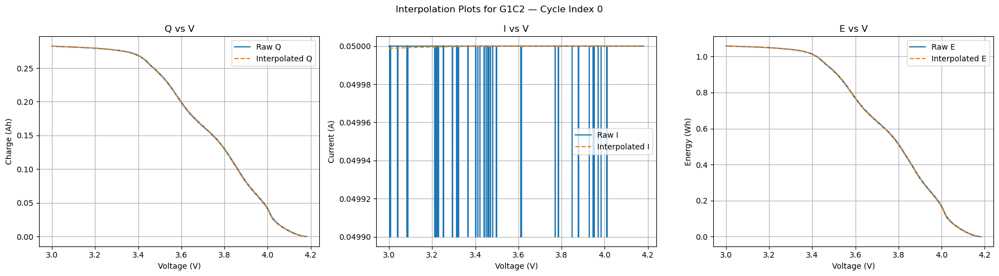

In [ ]:
builder.plot_qie_from_dataframe(df_isu_all_from_pkl, cell_id="G1C2", cycle_index=0)

In [22]:
df_isu_all_from_csv = pd.read_csv("../Datasets/isu_Interp_flat.csv")
df_isu_all_from_csv.select_dtypes(include='object').columns
builder.plot_qie_from_dataframe(df_isu_all_from_csv, cell_id="G1C1", cycle_index=1)

UFuncTypeError: ufunc 'greater_equal' did not contain a loop with signature matching types (<class 'numpy.dtypes.StrDType'>, <class 'numpy.dtypes.Float64DType'>) -> None